In [272]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import re

In [463]:
df = pd.read_csv("Scraped_dataset.csv")

In [464]:
df.head()

,Date of Booking,Date of Journey,Airline-Class,Departure Time,Arrival Time,Duration,Total Stops,Price
0,15/01/2023,16/01/2023,SpiceJet \nSG-8169\nECONOMY,20:00\nDelhi,22:05\nMumbai,02h 05m,non-stop,"5,335"
1,15/01/2023,16/01/2023,Indigo \n6E-2519\nECONOMY,23:00\nDelhi,01:20\nMumbai,02h 20m,non-stop,"5,899"
2,15/01/2023,16/01/2023,GO FIRST \nG8- 354\nECONOMY,22:30\nDelhi,00:40\nMumbai,02h 10m,non-stop,"5,801"
3,15/01/2023,16/01/2023,SpiceJet \nSG-8709\nECONOMY,18:50\nDelhi,20:55\nMumbai,02h 05m,non-stop,"5,794"
4,15/01/2023,16/01/2023,Air India \nAI-805\nECONOMY,20:00\nDelhi,22:10\nMumbai,02h 10m,non-stop,"5,955"


In [465]:
df

,Date of Booking,Date of Journey,Airline-Class,Departure Time,Arrival Time,Duration,Total Stops,Price
0,15/01/2023,16/01/2023,SpiceJet \nSG-8169\nECONOMY,20:00\nDelhi,22:05\nMumbai,02h 05m,non-stop,"5,335"
1,15/01/2023,16/01/2023,Indigo \n6E-2519\nECONOMY,23:00\nDelhi,01:20\nMumbai,02h 20m,non-stop,"5,899"
2,15/01/2023,16/01/2023,GO FIRST \nG8- 354\nECONOMY,22:30\nDelhi,00:40\nMumbai,02h 10m,non-stop,"5,801"
3,15/01/2023,16/01/2023,SpiceJet \nSG-8709\nECONOMY,18:50\nDelhi,20:55\nMumbai,02h 05m,non-stop,"5,794"
4,15/01/2023,16/01/2023,Air India \nAI-805\nECONOMY,20:00\nDelhi,22:10\nMumbai,02h 10m,non-stop,"5,955"
...,...,...,...,...,...,...,...,...
452083,15/01/2023,06/03/2023,Vistara \nUK-926\nBUSINESS,06:45\nAhmedabad,19:50\nChennai,13h 05m,1-stop,"65,028"
452084,15/01/2023,06/03/2023,Vistara \nUK-918\nBUSINESS,05:05\nAhmedabad,16:20\nChennai,11h 15m,1-stop,"69,254"
452085,15/01/2023,06/03/2023,Vistara \nUK-918\nBUSINESS,05:05\nAhmedabad,16:20\nChennai,11h 15m,1-stop,"69,254"
452086,15/01/2023,06/03/2023,Vistara \nUK-946\nBUSINESS,08:40\nAhmedabad,19:50\nChennai,11h 10m,1-stop,"72,980"


In [466]:
df.shape

(452088, 8)

In [467]:
df.duplicated().sum()

6722

In [468]:
df.isna().sum()

Date of Booking    0
Date of Journey    0
Airline-Class      0
Departure Time     0
Arrival Time       0
Duration           0
Total Stops        0
Price              0
dtype: int64

In [469]:
df.dtypes

Date of Booking    object
Date of Journey    object
Airline-Class      object
Departure Time     object
Arrival Time       object
Duration           object
Total Stops        object
Price              object
dtype: object

In [470]:
df=df.dropna()

In [471]:
df= df.reset_index(drop=True)

In [472]:
df.shape

(452088, 8)

In [473]:
df[['Airline', 'Flight_Number', 'Class']] = df['Airline-Class'].str.split('\n', expand=True)

In [474]:
df.head()

,Date of Booking,Date of Journey,Airline-Class,Departure Time,Arrival Time,Duration,Total Stops,Price,Airline,Flight_Number,Class
0,15/01/2023,16/01/2023,SpiceJet \nSG-8169\nECONOMY,20:00\nDelhi,22:05\nMumbai,02h 05m,non-stop,"5,335",SpiceJet,SG-8169,ECONOMY
1,15/01/2023,16/01/2023,Indigo \n6E-2519\nECONOMY,23:00\nDelhi,01:20\nMumbai,02h 20m,non-stop,"5,899",Indigo,6E-2519,ECONOMY
2,15/01/2023,16/01/2023,GO FIRST \nG8- 354\nECONOMY,22:30\nDelhi,00:40\nMumbai,02h 10m,non-stop,"5,801",GO FIRST,G8- 354,ECONOMY
3,15/01/2023,16/01/2023,SpiceJet \nSG-8709\nECONOMY,18:50\nDelhi,20:55\nMumbai,02h 05m,non-stop,"5,794",SpiceJet,SG-8709,ECONOMY
4,15/01/2023,16/01/2023,Air India \nAI-805\nECONOMY,20:00\nDelhi,22:10\nMumbai,02h 10m,non-stop,"5,955",Air India,AI-805,ECONOMY


In [475]:
df[['Departure_time','Departure_loc']] = df['Departure Time'].str.split('\n',expand=True)

In [476]:
df.head()

,Date of Booking,Date of Journey,Airline-Class,Departure Time,Arrival Time,Duration,Total Stops,Price,Airline,Flight_Number,Class,Departure_time,Departure_loc
0,15/01/2023,16/01/2023,SpiceJet \nSG-8169\nECONOMY,20:00\nDelhi,22:05\nMumbai,02h 05m,non-stop,"5,335",SpiceJet,SG-8169,ECONOMY,20:00,Delhi
1,15/01/2023,16/01/2023,Indigo \n6E-2519\nECONOMY,23:00\nDelhi,01:20\nMumbai,02h 20m,non-stop,"5,899",Indigo,6E-2519,ECONOMY,23:00,Delhi
2,15/01/2023,16/01/2023,GO FIRST \nG8- 354\nECONOMY,22:30\nDelhi,00:40\nMumbai,02h 10m,non-stop,"5,801",GO FIRST,G8- 354,ECONOMY,22:30,Delhi
3,15/01/2023,16/01/2023,SpiceJet \nSG-8709\nECONOMY,18:50\nDelhi,20:55\nMumbai,02h 05m,non-stop,"5,794",SpiceJet,SG-8709,ECONOMY,18:50,Delhi
4,15/01/2023,16/01/2023,Air India \nAI-805\nECONOMY,20:00\nDelhi,22:10\nMumbai,02h 10m,non-stop,"5,955",Air India,AI-805,ECONOMY,20:00,Delhi


In [477]:
df[['Destination_time','Destination_loc']] = df['Arrival Time'].str.split('\n',expand=True)

In [478]:
df.head()

,Date of Booking,Date of Journey,Airline-Class,Departure Time,Arrival Time,Duration,Total Stops,Price,Airline,Flight_Number,Class,Departure_time,Departure_loc,Destination_time,Destination_loc
0,15/01/2023,16/01/2023,SpiceJet \nSG-8169\nECONOMY,20:00\nDelhi,22:05\nMumbai,02h 05m,non-stop,"5,335",SpiceJet,SG-8169,ECONOMY,20:00,Delhi,22:05,Mumbai
1,15/01/2023,16/01/2023,Indigo \n6E-2519\nECONOMY,23:00\nDelhi,01:20\nMumbai,02h 20m,non-stop,"5,899",Indigo,6E-2519,ECONOMY,23:00,Delhi,01:20,Mumbai
2,15/01/2023,16/01/2023,GO FIRST \nG8- 354\nECONOMY,22:30\nDelhi,00:40\nMumbai,02h 10m,non-stop,"5,801",GO FIRST,G8- 354,ECONOMY,22:30,Delhi,00:40,Mumbai
3,15/01/2023,16/01/2023,SpiceJet \nSG-8709\nECONOMY,18:50\nDelhi,20:55\nMumbai,02h 05m,non-stop,"5,794",SpiceJet,SG-8709,ECONOMY,18:50,Delhi,20:55,Mumbai
4,15/01/2023,16/01/2023,Air India \nAI-805\nECONOMY,20:00\nDelhi,22:10\nMumbai,02h 10m,non-stop,"5,955",Air India,AI-805,ECONOMY,20:00,Delhi,22:10,Mumbai


In [479]:
df.drop(['Airline-Class','Departure Time','Arrival Time'],axis=1, inplace=True)

In [480]:
df.head()

,Date of Booking,Date of Journey,Duration,Total Stops,Price,Airline,Flight_Number,Class,Departure_time,Departure_loc,Destination_time,Destination_loc
0,15/01/2023,16/01/2023,02h 05m,non-stop,"5,335",SpiceJet,SG-8169,ECONOMY,20:00,Delhi,22:05,Mumbai
1,15/01/2023,16/01/2023,02h 20m,non-stop,"5,899",Indigo,6E-2519,ECONOMY,23:00,Delhi,01:20,Mumbai
2,15/01/2023,16/01/2023,02h 10m,non-stop,"5,801",GO FIRST,G8- 354,ECONOMY,22:30,Delhi,00:40,Mumbai
3,15/01/2023,16/01/2023,02h 05m,non-stop,"5,794",SpiceJet,SG-8709,ECONOMY,18:50,Delhi,20:55,Mumbai
4,15/01/2023,16/01/2023,02h 10m,non-stop,"5,955",Air India,AI-805,ECONOMY,20:00,Delhi,22:10,Mumbai


In [481]:
from datetime import datetime

df['Departure_time'] = df['Departure_time'].apply(lambda x: datetime.strptime(x, '%H:%M').strftime("%I:%M:%p"))

df['Destination_time'] = df['Destination_time'].apply(lambda x: datetime.strptime(x, '%H:%M').strftime("%I:%M:%p"))

In [482]:
df.head()

,Date of Booking,Date of Journey,Duration,Total Stops,Price,Airline,Flight_Number,Class,Departure_time,Departure_loc,Destination_time,Destination_loc
0,15/01/2023,16/01/2023,02h 05m,non-stop,"5,335",SpiceJet,SG-8169,ECONOMY,08:00:PM,Delhi,10:05:PM,Mumbai
1,15/01/2023,16/01/2023,02h 20m,non-stop,"5,899",Indigo,6E-2519,ECONOMY,11:00:PM,Delhi,01:20:AM,Mumbai
2,15/01/2023,16/01/2023,02h 10m,non-stop,"5,801",GO FIRST,G8- 354,ECONOMY,10:30:PM,Delhi,12:40:AM,Mumbai
3,15/01/2023,16/01/2023,02h 05m,non-stop,"5,794",SpiceJet,SG-8709,ECONOMY,06:50:PM,Delhi,08:55:PM,Mumbai
4,15/01/2023,16/01/2023,02h 10m,non-stop,"5,955",Air India,AI-805,ECONOMY,08:00:PM,Delhi,10:10:PM,Mumbai


In [483]:
df['Booking_date'] = pd.to_datetime(df['Date of Booking'], format='%d/%m/%Y')

In [484]:
df.head()

,Date of Booking,Date of Journey,Duration,Total Stops,Price,Airline,Flight_Number,Class,Departure_time,Departure_loc,Destination_time,Destination_loc,Booking_date
0,15/01/2023,16/01/2023,02h 05m,non-stop,"5,335",SpiceJet,SG-8169,ECONOMY,08:00:PM,Delhi,10:05:PM,Mumbai,2023-01-15
1,15/01/2023,16/01/2023,02h 20m,non-stop,"5,899",Indigo,6E-2519,ECONOMY,11:00:PM,Delhi,01:20:AM,Mumbai,2023-01-15
2,15/01/2023,16/01/2023,02h 10m,non-stop,"5,801",GO FIRST,G8- 354,ECONOMY,10:30:PM,Delhi,12:40:AM,Mumbai,2023-01-15
3,15/01/2023,16/01/2023,02h 05m,non-stop,"5,794",SpiceJet,SG-8709,ECONOMY,06:50:PM,Delhi,08:55:PM,Mumbai,2023-01-15
4,15/01/2023,16/01/2023,02h 10m,non-stop,"5,955",Air India,AI-805,ECONOMY,08:00:PM,Delhi,10:10:PM,Mumbai,2023-01-15


In [492]:
df['Journey_date'] = pd.to_datetime(df['Date of Journey'],format='%d/%m/%Y')
df['Journey_day'] = df['Date of Journey'].dt.strftime('%A')

In [493]:
df.head()

,Date of Booking,Date of Journey,Duration,Total Stops,Price,Airline,Flight_Number,Class,Departure_time,Departure_loc,Destination_time,Destination_loc,Booking_date,Journey_day,Days_left,Journey_date
0,15/01/2023,2023-01-16,02h 05m,non-stop,"5,335",SpiceJet,SG-8169,ECONOMY,08:00:PM,Delhi,10:05:PM,Mumbai,2023-01-15,Monday,1,2023-01-16
1,15/01/2023,2023-01-16,02h 20m,non-stop,"5,899",Indigo,6E-2519,ECONOMY,11:00:PM,Delhi,01:20:AM,Mumbai,2023-01-15,Monday,1,2023-01-16
2,15/01/2023,2023-01-16,02h 10m,non-stop,"5,801",GO FIRST,G8- 354,ECONOMY,10:30:PM,Delhi,12:40:AM,Mumbai,2023-01-15,Monday,1,2023-01-16
3,15/01/2023,2023-01-16,02h 05m,non-stop,"5,794",SpiceJet,SG-8709,ECONOMY,06:50:PM,Delhi,08:55:PM,Mumbai,2023-01-15,Monday,1,2023-01-16
4,15/01/2023,2023-01-16,02h 10m,non-stop,"5,955",Air India,AI-805,ECONOMY,08:00:PM,Delhi,10:10:PM,Mumbai,2023-01-15,Monday,1,2023-01-16


In [494]:
df['Days_left'] = df['Journey_date']-df['Booking_date']
df.head()

,Date of Booking,Date of Journey,Duration,Total Stops,Price,Airline,Flight_Number,Class,Departure_time,Departure_loc,Destination_time,Destination_loc,Booking_date,Journey_day,Days_left,Journey_date
0,15/01/2023,2023-01-16,02h 05m,non-stop,"5,335",SpiceJet,SG-8169,ECONOMY,08:00:PM,Delhi,10:05:PM,Mumbai,2023-01-15,Monday,1 days,2023-01-16
1,15/01/2023,2023-01-16,02h 20m,non-stop,"5,899",Indigo,6E-2519,ECONOMY,11:00:PM,Delhi,01:20:AM,Mumbai,2023-01-15,Monday,1 days,2023-01-16
2,15/01/2023,2023-01-16,02h 10m,non-stop,"5,801",GO FIRST,G8- 354,ECONOMY,10:30:PM,Delhi,12:40:AM,Mumbai,2023-01-15,Monday,1 days,2023-01-16
3,15/01/2023,2023-01-16,02h 05m,non-stop,"5,794",SpiceJet,SG-8709,ECONOMY,06:50:PM,Delhi,08:55:PM,Mumbai,2023-01-15,Monday,1 days,2023-01-16
4,15/01/2023,2023-01-16,02h 10m,non-stop,"5,955",Air India,AI-805,ECONOMY,08:00:PM,Delhi,10:10:PM,Mumbai,2023-01-15,Monday,1 days,2023-01-16


In [495]:
df['Days_left'] = df['Days_left'].astype(str)
df['Days_left'] = df['Days_left'].apply(lambda x: re.findall('\d+', x)[0])
df['Days_left'] = pd.to_numeric(df['Days_left'])

In [496]:
col_order = ['Journey_date','Journey_day','Days_left','Airline','Flight_Number','Class','Departure_time','Departure_loc',
             'Destination_time','Destination_loc','Duration','Total Stops','Price']

df = df[col_order]

df.head()

,Journey_date,Journey_day,Days_left,Airline,Flight_Number,Class,Departure_time,Departure_loc,Destination_time,Destination_loc,Duration,Total Stops,Price
0,2023-01-16,Monday,1,SpiceJet,SG-8169,ECONOMY,08:00:PM,Delhi,10:05:PM,Mumbai,02h 05m,non-stop,"5,335"
1,2023-01-16,Monday,1,Indigo,6E-2519,ECONOMY,11:00:PM,Delhi,01:20:AM,Mumbai,02h 20m,non-stop,"5,899"
2,2023-01-16,Monday,1,GO FIRST,G8- 354,ECONOMY,10:30:PM,Delhi,12:40:AM,Mumbai,02h 10m,non-stop,"5,801"
3,2023-01-16,Monday,1,SpiceJet,SG-8709,ECONOMY,06:50:PM,Delhi,08:55:PM,Mumbai,02h 05m,non-stop,"5,794"
4,2023-01-16,Monday,1,Air India,AI-805,ECONOMY,08:00:PM,Delhi,10:10:PM,Mumbai,02h 10m,non-stop,"5,955"


In [500]:
df.dtypes

Journey_date        datetime64[ns]
Journey_day                 object
Days_left                    int64
Airline                     object
Flight_Number               object
Class                       object
Departure_time              object
Departure_loc               object
Destination_time            object
Destination_loc             object
Duration                    object
Total Stops                 object
Price                       object
dtype: object

In [501]:
df['Price'] = df['Price'].str.replace(',','')

C:\Users\malli\AppData\Local\Temp\ipykernel_28864\986327726.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [502]:
df['Price'] = pd.to_numeric(df['Price'])

C:\Users\malli\AppData\Local\Temp\ipykernel_28864\3793862318.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [503]:
df.dtypes

Journey_date        datetime64[ns]
Journey_day                 object
Days_left                    int64
Airline                     object
Flight_Number               object
Class                       object
Departure_time              object
Departure_loc               object
Destination_time            object
Destination_loc             object
Duration                    object
Total Stops                 object
Price                        int64
dtype: object

In [504]:
df.shape

(452088, 13)

In [505]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Days_left,452088.0,25.627902,14.300846,1.0,13.00,26.0,38.0,50.0
Price,452088.0,22840.100890,20307.963002,1307.0,8762.75,13407.0,35587.0,143019.0


In [506]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 452088 entries, 0 to 452087
Data columns (total 13 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Journey_date      452088 non-null  datetime64[ns]
 1   Journey_day       452088 non-null  object        
 2   Days_left         452088 non-null  int64         
 3   Airline           452088 non-null  object        
 4   Flight_Number     452088 non-null  object        
 5   Class             452088 non-null  object        
 6   Departure_time    452088 non-null  object        
 7   Departure_loc     452088 non-null  object        
 8   Destination_time  452088 non-null  object        
 9   Destination_loc   452088 non-null  object        
 10  Duration          452088 non-null  object        
 11  Total Stops       452088 non-null  object        
 12  Price             452088 non-null  int64         
dtypes: datetime64[ns](1), int64(2), object(10)
memory usage: 44

In [507]:
df.to_csv("Airfair.csv",index=False)

In [436]:
df.sample(5)

,Journey_date,Journey_day,Days_left,Airline,Flight_Number,Class,Departure_time,Departure_loc,Destination_time,Destination_loc,Duration,Total Stops,Price
44381,2023-02-13,Monday,29 days,Vistara,UK-981,ECONOMY,09:40:PM,Delhi,07:45:AM,Hyderabad,10h 05m,1-stop,9840
82446,2023-03-03,Friday,47 days,Vistara,UK-951,ECONOMY,02:20:PM,Delhi,11:55:PM,Ahmedabad,09h 35m,1-stop,8139
286498,2023-02-28,Tuesday,44 days,Indigo,6E- 949,ECONOMY,11:55:PM,Hyderabad,07:55:AM,Chennai,08h 00m,1-stop,3885
383656,2023-01-22,Sunday,7 days,Vistara,UK-826,ECONOMY,12:30:PM,Chennai,12:05:AM,Hyderabad,11h 35m,1-stop,13708
320601,2023-01-28,Saturday,13 days,Air India,AI-775,ECONOMY,04:15:PM,Kolkata,08:30:PM,Bangalore,28h 15m,1-stop,14246


In [437]:
df['Total Stops'].unique()

array(['non-stop', '1-stop', '2+-stop',
       '1-stop\n\t\t\t\t\t\t\t\t\t\t\t\tVia Indore',
       '1-stop\n\t\t\t\t\t\t\t\t\t\t\t\tVia IDR',
       '1-stop\n\t\t\t\t\t\t\t\t\t\t\t\tVia DIB',
       '1-stop\n\t\t\t\t\t\t\t\t\t\t\t\tVia Guwahati',
       '1-stop\n\t\t\t\t\t\t\t\t\t\t\t\tVia VTZ',
       '1-stop\n\t\t\t\t\t\t\t\t\t\t\t\tVia RPR',
       '1-stop\n\t\t\t\t\t\t\t\t\t\t\t\tVia Mumbai',
       '1-stop\n\t\t\t\t\t\t\t\t\t\t\t\tVia Delhi',
       '1-stop\n\t\t\t\t\t\t\t\t\t\t\t\tVia Pune',
       '1-stop\n\t\t\t\t\t\t\t\t\t\t\t\tVia PNQ'], dtype=object)

In [438]:
df[df['Total Stops']=='2+-stop']

,Journey_date,Journey_day,Days_left,Airline,Flight_Number,Class,Departure_time,Departure_loc,Destination_time,Destination_loc,Duration,Total Stops,Price
88,2023-01-16,Monday,1 days,AirAsia,I5-745,ECONOMY,01:15:PM,Delhi,04:00:AM,Mumbai,14h 45m,2+-stop,10882
108,2023-01-16,Monday,1 days,AirAsia,I5-745,ECONOMY,01:15:PM,Delhi,02:20:AM,Mumbai,13h 05m,2+-stop,12040
162,2023-01-16,Monday,1 days,AirAsia,I5-711,ECONOMY,05:45:AM,Delhi,09:00:PM,Mumbai,15h 15m,2+-stop,18211
546,2023-01-17,Tuesday,2 days,AirAsia,I5-711,ECONOMY,05:45:AM,Delhi,09:00:PM,Mumbai,15h 15m,2+-stop,16535
944,2023-01-18,Wednesday,3 days,AirAsia,I5-711,ECONOMY,05:45:AM,Delhi,09:00:PM,Mumbai,15h 15m,2+-stop,16535
...,...,...,...,...,...,...,...,...,...,...,...,...,...
445221,2023-01-18,Wednesday,3 days,Air India,AI-481,BUSINESS,10:40:AM,Ahmedabad,10:35:PM,Chennai,11h 55m,2+-stop,75211
445222,2023-01-18,Wednesday,3 days,Air India,AI-481,BUSINESS,10:40:AM,Ahmedabad,11:35:PM,Chennai,12h 55m,2+-stop,75211
445825,2023-01-23,Monday,8 days,Air India,AI-481,ECONOMY,10:40:AM,Ahmedabad,10:35:PM,Chennai,11h 55m,2+-stop,16581
448120,2023-02-08,Wednesday,24 days,Air India,AI-481,ECONOMY,10:40:AM,Ahmedabad,10:35:PM,Chennai,11h 55m,2+-stop,15489


In [440]:
df_airlines=df.groupby(['Airline','Flight_Number'],as_index=False).count()
df_airlines.Airline.value_counts()

Indigo          702
Air India       171
Vistara         165
AirAsia         106
GO FIRST        104
SpiceJet         92
AkasaAir         51
AllianceAir      10
StarAir           4
Name: Airline, dtype: int64

In [441]:
df['Class'].unique()

array(['ECONOMY', 'PREMIUMECONOMY', 'BUSINESS', 'FIRST'], dtype=object)

In [442]:
df['Class'].value_counts()

ECONOMY           252033
BUSINESS          126834
PREMIUMECONOMY     73077
FIRST                144
Name: Class, dtype: int64

In [443]:
df_class = df.groupby(['Airline','Flight_Number','Class'],as_index=False).count()
df_class.Class.value_counts()

ECONOMY           1401
BUSINESS           295
PREMIUMECONOMY     137
FIRST                3
Name: Class, dtype: int64

In [444]:
df_class.Airline.value_counts()

Indigo          702
Vistara         447
Air India       320
AirAsia         106
GO FIRST        104
SpiceJet         92
AkasaAir         51
AllianceAir      10
StarAir           4
Name: Airline, dtype: int64

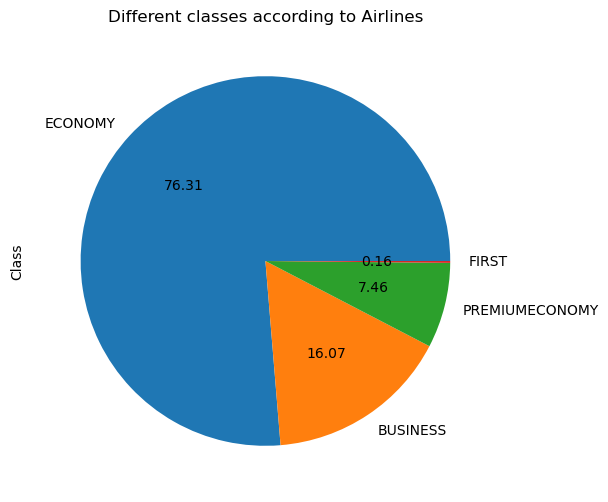

In [445]:
plt.figure(figsize=(8,6))
df_class['Class'].value_counts().plot(kind='pie',textprops={'color':'black'},autopct='%.2f')
plt.title("Different classes according to Airlines")
plt.show()

In [446]:
import plotly.express as px
plt.figure(figsize=(10,6))
fig_price = px.box(df, x='Airline', y='Price',template='seaborn')
fig_price.show()

<Figure size 1000x600 with 0 Axes>

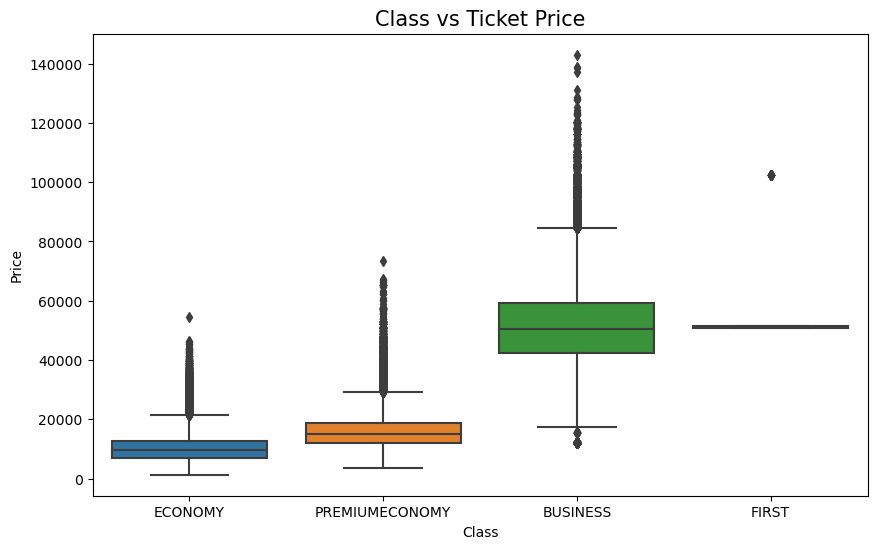

In [447]:
plt.figure(figsize=(10,6))
sns.boxplot(data=df, x='Class',y='Price')
plt.title('Class vs Ticket Price',fontsize=15)
plt.xlabel('Class')
plt.ylabel('Price')
plt.show()

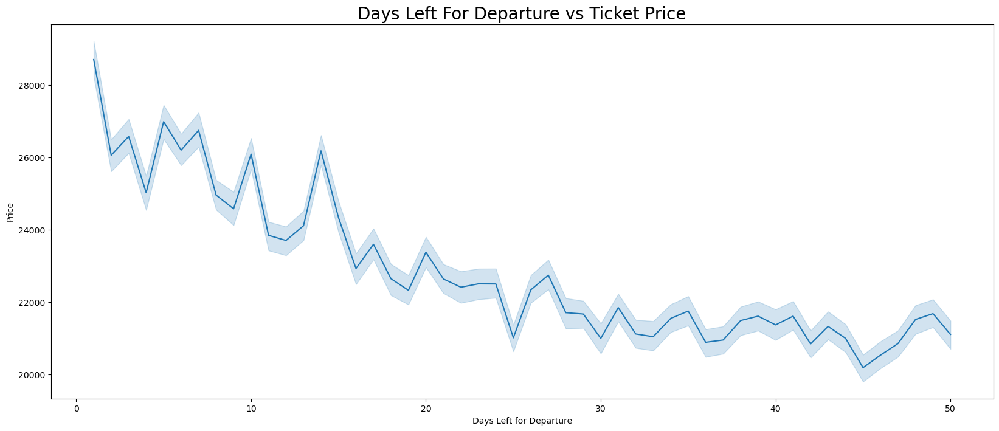

In [448]:
plt.figure(figsize=(20,8))
fig_dp=sns.lineplot(data=d, x='Days_left',y='Fare')
plt.title('Days Left For Departure vs Ticket Price',fontsize=20)
plt.xlabel('Days Left for Departure')
plt.ylabel('Price')
plt.show()

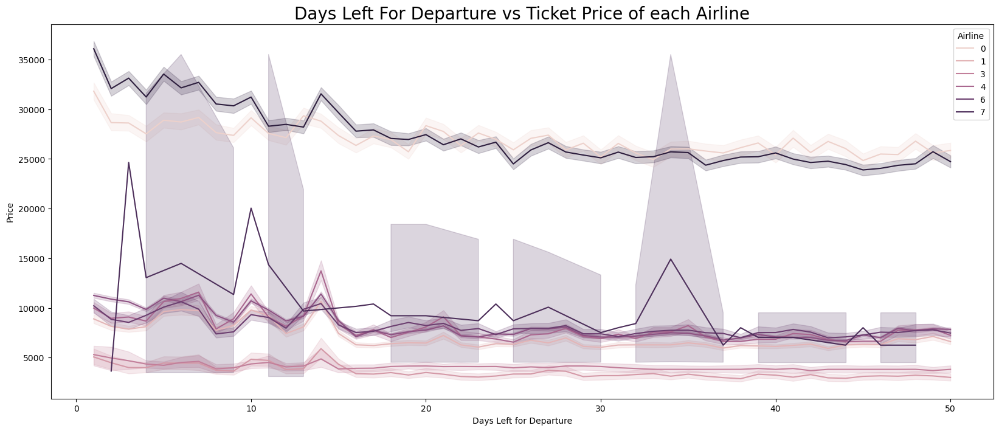

In [449]:
plt.figure(figsize=(20,8))
fig_dp=sns.lineplot(data=d, x='Days_left',y='Fare',hue='Airline')
plt.title('Days Left For Departure vs Ticket Price of each Airline',fontsize=20)
plt.xlabel('Days Left for Departure')
plt.ylabel('Price')
plt.show()

In [450]:
df.columns

Index(['Journey_date', 'Journey_day', 'Days_left', 'Airline', 'Flight_Number',
       'Class', 'Departure_time', 'Departure_loc', 'Destination_time',
       'Destination_loc', 'Duration', 'Total Stops', 'Price'],
      dtype='object')

In [451]:
df.groupby(['Flight_Number','Departure_loc','Destination_loc','Airline','Class'],as_index=False).count().groupby([
'Departure_loc','Destination_loc'],as_index=False)['Flight_Number'].count().sort_values(by='Flight_Number',ascending=False)

,Departure_loc,Destination_loc,Flight_Number
23,Delhi,Mumbai,361
39,Mumbai,Delhi,312
19,Delhi,Bangalore,281
20,Delhi,Chennai,250
22,Delhi,Kolkata,228
21,Delhi,Hyderabad,222
37,Mumbai,Bangalore,221
41,Mumbai,Kolkata,215
38,Mumbai,Chennai,195
40,Mumbai,Hyderabad,192


In [452]:
df.groupby(['Airline','Departure_loc','Destination_loc','Duration'],as_index=False)['Price'].mean()

,Airline,Departure_loc,Destination_loc,Duration,Price
0,Air India,Ahmedabad,Bangalore,05h 35m,33286.743590
1,Air India,Ahmedabad,Bangalore,05h 40m,27259.000000
2,Air India,Ahmedabad,Bangalore,08h 00m,34592.850000
3,Air India,Ahmedabad,Bangalore,08h 15m,36016.500000
4,Air India,Ahmedabad,Bangalore,08h 30m,35424.870968
...,...,...,...,...,...
8825,Vistara,Mumbai,Kolkata,37h 15m,19185.000000
8826,Vistara,Mumbai,Kolkata,37h 35m,20792.000000
8827,Vistara,Mumbai,Kolkata,39h 20m,24253.000000
8828,Vistara,Mumbai,Kolkata,39h 45m,15059.666667


In [453]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
for col in df.columns:
    if df[col].dtype=='object':
        df[col]=le.fit_transform(df[col])

C:\Users\malli\AppData\Local\Temp\ipykernel_28864\3589862287.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [454]:
df.dtypes

Journey_date        int64
Journey_day         int32
Days_left           int64
Airline             int32
Flight_Number       int32
Class               int32
Departure_time      int32
Departure_loc       int32
Destination_time    int32
Destination_loc     int32
Duration            int32
Total Stops         int32
Price               int64
dtype: object

In [456]:
df['Journey_date'].value_counts()

15    9824
29    9523
30    9510
45    9433
11    9414
24    9381
33    9374
18    9354
44    9342
28    9331
10    9325
20    9321
27    9277
39    9273
23    9264
25    9239
16    9234
49    9222
31    9210
13    9162
35    9162
38    9112
14    9103
9     9066
22    9052
36    9043
42    9042
12    9028
43    9017
19    9012
41    9009
40    9001
21    8980
17    8971
46    8904
7     8898
4     8891
26    8867
32    8857
8     8786
3     8755
37    8708
47    8627
5     8608
48    8584
2     8556
0     8482
34    8461
6     8336
1     8157
Name: Journey_date, dtype: int64

In [457]:
df

,Journey_date,Journey_day,Days_left,Airline,Flight_Number,Class,Departure_time,Departure_loc,Destination_time,Destination_loc,Duration,Total Stops,Price
0,0,1,0,6,1214,1,148,3,196,6,17,12,1148
1,0,1,0,5,356,1,220,3,8,6,20,12,1575
2,0,1,0,4,929,1,208,3,258,6,18,12,1497
3,0,1,0,6,1228,1,120,3,168,6,17,12,1491
4,0,1,0,0,852,1,148,3,198,6,18,12,1613
...,...,...,...,...,...,...,...,...,...,...,...,...,...
452083,49,1,49,8,1360,0,117,0,142,2,149,0,19208
452084,49,1,49,8,1358,0,77,0,69,2,127,0,19450
452085,49,1,49,8,1358,0,77,0,69,2,127,0,19450
452086,49,1,49,8,1374,0,163,0,142,2,126,0,19653


In [458]:
X=df.drop(['Price'],axis=1)
y=df['Price']

In [459]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.30,random_state=42)
X_train.shape,X_test.shape,y_train.shape,y_test.shape

((316461, 12), (135627, 12), (316461,), (135627,))

In [460]:
from sklearn.preprocessing import MinMaxScaler
mmscaler=MinMaxScaler(feature_range=(0,1))
X_train=mmscaler.fit_transform(X_train)
X_test=mmscaler.fit_transform(X_test)

In [461]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn import linear_model
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
import xgboost as xgb
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.ensemble import GradientBoostingRegressor